# 1. Build an image segmentation model using pytorch

In [1]:
import pandas as pd
import torch
import torchvision.models as models
import torch.nn as nn
import torch.nn.functional as F
import torchvision.transforms.functional as TF
from torch.utils.data import Dataset,DataLoader, random_split
from torchvision import datasets, transforms
import torch.optim as optim
import torch.optim.lr_scheduler as lr_scheduler

from PIL import Image
import random
import os
import cv2

import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np


In [2]:
class Decoderblock(nn.Module):
    def __init__(self, in_channels, middle):
        super(Decoderblock, self).__init__()
        middle_channels = int(in_channels / middle)
        self.decode = nn.Sequential(nn.ConvTranspose2d(in_channels, in_channels, kernel_size=3, stride=3, output_padding=2),
                                    nn.Conv2d(in_channels, middle_channels, kernel_size=3, padding=1),
                                    nn.BatchNorm2d(middle_channels),
                                    nn.ReLU(inplace=True),)

    def forward(self, x):
        return self.decode(x)
    
class SegNet(nn.Module):
    def __init__(self, in_channels=3, out_channels=1):
        super(SegNet, self).__init__()
        
        # Pre-trained encoder
        resnet = models.resnet50(pretrained=True)
    
            
        self.encoder = nn.Sequential(*list(resnet.children())[:-2]) # total has 9 layers
        
        # Freeze all layers except the last few layers
        for layer in self.encoder[-3:]:
            for param in layer.parameters():
                    param.requires_grad = True
        
        self.last_dec= nn.Sequential(nn.ConvTranspose2d(64, 64, kernel_size=10, stride=1, output_padding=0),
                                    nn.Conv2d(64, 1, kernel_size=3, padding=1),
                                    nn.BatchNorm2d(1),
                                    nn.ReLU(inplace=True),)
        
        # Decoder layers
        self.dec1 = Decoderblock(2048,4)
        self.dec2 = Decoderblock(512,2)
        self.dec3 = Decoderblock(256,4)
        
    def forward(self, x):
        # Encoder
        feature = self.encoder(x)
        #print(feature.shape)

        
        # Decoder
        dec1 = self.dec1(feature)
        #print(dec1.shape)
        dec2 = self.dec2(dec1)
        #print(dec2.shape)
        dec3 = self.dec3(dec2)
        #print(dec3.shape) 
        dec4 = self.last_dec(dec3)
        #print(dec4.shape) 
        
        return dec4


# 2. Train your model using [lung segmentation datasets](https://github.com/YoushanZhang/Lung_Segmentation)

In [3]:
train_path = r'D:\application for the usa\YU\6. Deep learning\HW 11 _ Project3\Lung_segmentation\Train'
test_path = r'D:\application for the usa\YU\6. Deep learning\HW 11 _ Project3\Lung_segmentation\Test'

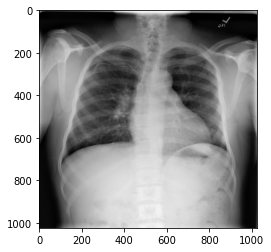

In [4]:
os.environ['KMP_DUPLICATE_LIB_OK'] = 'True'
img = np.asarray(Image.open(r'D:\application for the usa\YU\6. Deep learning\HW 11 _ Project3\Lung_segmentation\Train\Images\1.png'))
plt.imshow(img,'gray')

In [5]:
img.shape

(1024, 1024)

In [6]:
class Importdata(Dataset):
    def __init__(self, root, transform=None):
        self.root = root
        self.transform = transform
        self.folders = os.listdir(root)
        self.image = sorted(os.listdir(os.path.join(root, self.folders[0])))
        self.mask = sorted(os.listdir(os.path.join(root, self.folders[1])))

    def __len__(self):
        return len(self.image)

    def __getitem__(self, idx):
        
        img_path = os.path.join(self.root, self.folders[0], self.image[idx])
        mask_path = os.path.join(self.root, self.folders[1], self.mask[idx])
        
        img = Image.open(img_path).convert('RGB')
        mask = Image.open(mask_path).convert('L')
        
        mask_transform = transforms.Compose([transforms.Resize((224,224)),transforms.ToTensor()])
        
        if self.transform:
            img = self.transform(img)
            mask = mask_transform(mask)

        return img, mask, self.image[idx], self.mask[idx]



In [7]:
img_transform = transforms.Compose([transforms.Resize((224,224)),
                                    transforms.ToTensor(),
                                    transforms.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))])#(0.485,), (0.229,)

In [8]:
train_set = Importdata(train_path, transform = img_transform)
test_set = Importdata(test_path, transform = img_transform)
train_loader = torch.utils.data.DataLoader(dataset=train_set, batch_size=4, shuffle=True)
test_loader = torch.utils.data.DataLoader(dataset=test_set, batch_size=4, shuffle=False)

In [9]:
def gen_img(loader, num_img):
    img, mask, img_path, mask_path = next(iter(loader))
    print(img.shape)
    os.environ['KMP_DUPLICATE_LIB_OK'] = 'True'
    for i in range(num_img): 
        fig, ax = plt.subplots(figsize=(15,6))
        # Plot X-ray image
        ax.imshow(img[i].permute(1,2,0), 'gray')
        # Overlay lung mask on X-ray image
        mask_array = mask[i].squeeze().numpy()  # Remove batch and channel dimensions
        mask_array = np.ma.masked_where(mask_array == 0, mask_array)  # Mask pixels with zero values
        ax.imshow(mask_array, alpha=0.2)
        plt.title(f'img: {img_path[i]}, mask: {mask_path[i]} ')
        plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


torch.Size([4, 3, 224, 224])


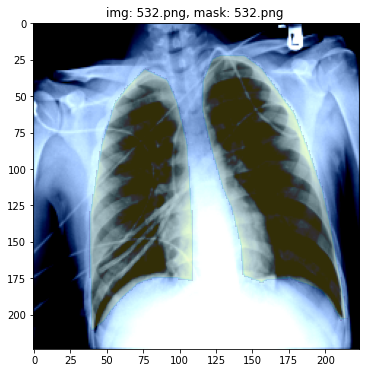

In [10]:
gen_img(train_loader , 1)

In [11]:
model = SegNet().to('cuda')


# Define the optimizer
optimizer = torch.optim.Adam(model.parameters(), lr=1e-5 , weight_decay=5e-4)

# Define your scheduler
#scheduler = lr_scheduler.StepLR(optimizer, step_size=30, gamma=0.5)

criterion = nn.BCEWithLogitsLoss()

In [12]:
train_parameter = sum(parameter.numel() for parameter in model.parameters() if parameter.requires_grad)
print('Total train parameters:',train_parameter)

Total train parameters: 75385731


In [13]:
def calioudice(pred_mask, true_mask):
    sum_iou = 0
    sum_dice = 0
    sigmoid = nn.Sigmoid()
    pred_mask = sigmoid(pred_mask)
    pred_mask = (pred_mask>0.5).float()
    #print(pred_mask.shape)
    #print(true_mask.shape)
    for i in range(pred_mask.shape[0]):
        
        intersect = torch.logical_and(pred_mask[i][0], true_mask[i][0])
        union = torch.logical_or(pred_mask[i][0], true_mask[i][0])       
        IoU = torch.sum(intersect)/torch.sum(union)
        A_B = (pred_mask[i][0]+true_mask[i][0]).sum()
        
        dice = 2*torch.sum(intersect)/A_B
        #print(dice)
        
        
        sum_iou+=IoU
        sum_dice+=dice
    
    
    mean_iou=sum_iou/pred_mask.shape[0]
    mean_dice=sum_dice/pred_mask.shape[0]
    '''
    IoU_loss = 1-mean_iou
    Dice_loss = 1-mean_dice
    #print( IoU_loss, Dice_loss)
    loss = 0.5*IoU_loss + 0.5*Dice_loss
    '''
    
    return mean_iou, mean_dice

In [15]:
from datetime import datetime
start_time = datetime.now()
# Train the model
num_epochs = 30
all_trainloss= []
all_testloss= []
all_train_iou=[]
all_test_iou=[]
all_train_dice=[]
all_test_dice=[]

for epoch in range(num_epochs):
    model.train()
    train_loss, test_loss = 0, 0
    train_iou, test_iou = 0, 0
    train_dice, test_dice = 0, 0
    for image, mask, img_label, mask_label in train_loader:

        # Forward pass
        
        image, mask = image.to('cuda',dtype=torch.float), mask.to('cuda',dtype=torch.float)
        optimizer.zero_grad()
        mask_pred = model(image)
        #print(mask_pred)
        
        #print(mask_pred.shape)
        mean_iou, mean_dice = calioudice(mask_pred, mask)
        
        mask = mask.view(mask.size(0), -1)
        mask_pred = mask_pred.view(mask_pred.size(0), -1)
        #print(mask.shape)
        #print(mask_pred.shape)

        loss = criterion(mask_pred, mask)

        '''
        l2_regularization = torch.tensor(0.).to('cuda')
        for param in model.parameters():
            l2_regularization += torch.norm(param, p=2)
        loss += 0.01 * l2_regularization
        '''
        # Backward pass
        
        loss.backward()
        optimizer.step()
        train_loss+=loss.item()        
        train_dice+=mean_dice.item()
        train_iou+=mean_iou.item()
        
   
    # Testing   
    model.eval()
    for image, mask, img_label, mask_label in test_loader:
        
        # Forward pass
        image, mask = image.to('cuda',dtype=torch.float), mask.to('cuda',dtype=torch.float)

        mask_pred = model(image)

        t_mean_iou, t_mean_dice = calioudice(mask_pred, mask)
        
        mask = mask.view(mask.size(0), -1)
        mask_pred = mask_pred.view(mask_pred.size(0), -1)       
        
        t_loss = criterion(mask_pred, mask)
        
        test_loss+=t_loss.item()   
        test_dice+=t_mean_dice.item()
        test_iou+=t_mean_iou.item()
        
    train_loss/=len(train_loader)
    test_loss /= len(test_loader)
    train_iou/=len(train_loader)
    test_iou /= len(test_loader)   
    train_dice/=len(train_loader)
    test_dice /= len(test_loader) 
        
    all_trainloss.append(train_loss)   
    all_testloss.append(test_loss)
    all_train_iou.append(train_iou*100)
    all_test_iou.append(test_iou*100)
    all_train_dice.append(train_dice*100)
    all_test_dice.append(test_dice*100)
    
    #scheduler.step()
    
    if test_iou >= 0.8 or (epoch+1)%100 == 0:
        PATH = f'seg_{epoch+1}_v4.pth'
        torch.save(model.state_dict(), PATH)   


    # Print the loss and accuracy
    print(f"Epoch {epoch+1}, Loss: {train_loss:.4f}, IoU:{train_iou*100:.4f}, Dice:{train_dice*100:.4f}, testLoss: { test_loss:.4f}, testIoU:{test_iou*100:.4f}, testDice:{test_dice*100:.4f}")

end_time = datetime.now()
print('Duration: {}'.format(end_time - start_time))

C:\Users\User\anaconda3\envs\dlenv\lib\site-packages\torch\nn\functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  ..\c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


Epoch 1, Loss: 0.6143, IoU:67.3070, Dice:81.4971, testLoss: 0.5812, testIoU:77.6382, testDice:89.3446
Epoch 2, Loss: 0.5803, IoU:79.8186, Dice:90.8001, testLoss: 0.5756, testIoU:81.0137, testDice:91.5728
Epoch 3, Loss: 0.5718, IoU:83.1252, Dice:92.9422, testLoss: 0.5819, testIoU:83.3025, testDice:92.9866
Epoch 4, Loss: 0.5675, IoU:84.7135, Dice:93.9460, testLoss: 0.5667, testIoU:83.1569, testDice:92.9738
Epoch 5, Loss: 0.5636, IoU:86.2795, Dice:94.9251, testLoss: 0.5581, testIoU:84.1618, testDice:93.5849
Epoch 6, Loss: 0.5615, IoU:87.1968, Dice:95.4748, testLoss: 0.5535, testIoU:85.2475, testDice:94.2078
Epoch 7, Loss: 0.5597, IoU:87.9352, Dice:95.9180, testLoss: 0.5624, testIoU:84.6818, testDice:93.9076
Epoch 8, Loss: 0.5581, IoU:88.6064, Dice:96.3155, testLoss: 0.5700, testIoU:84.9064, testDice:94.0442
Epoch 9, Loss: 0.5570, IoU:89.2004, Dice:96.6592, testLoss: 0.5739, testIoU:84.5137, testDice:93.8221
Epoch 10, Loss: 0.5557, IoU:89.7984, Dice:97.0086, testLoss: 0.5579, testIoU:85.07

In [16]:
df = pd.DataFrame(zip(all_trainloss,all_train_iou,all_train_dice,all_testloss,all_test_iou,all_test_dice),
                  columns=['train_loss','train_iou','train_dice','test_loss','test_iou','test_dice'])

Text(0.5, 0, 'epoch')

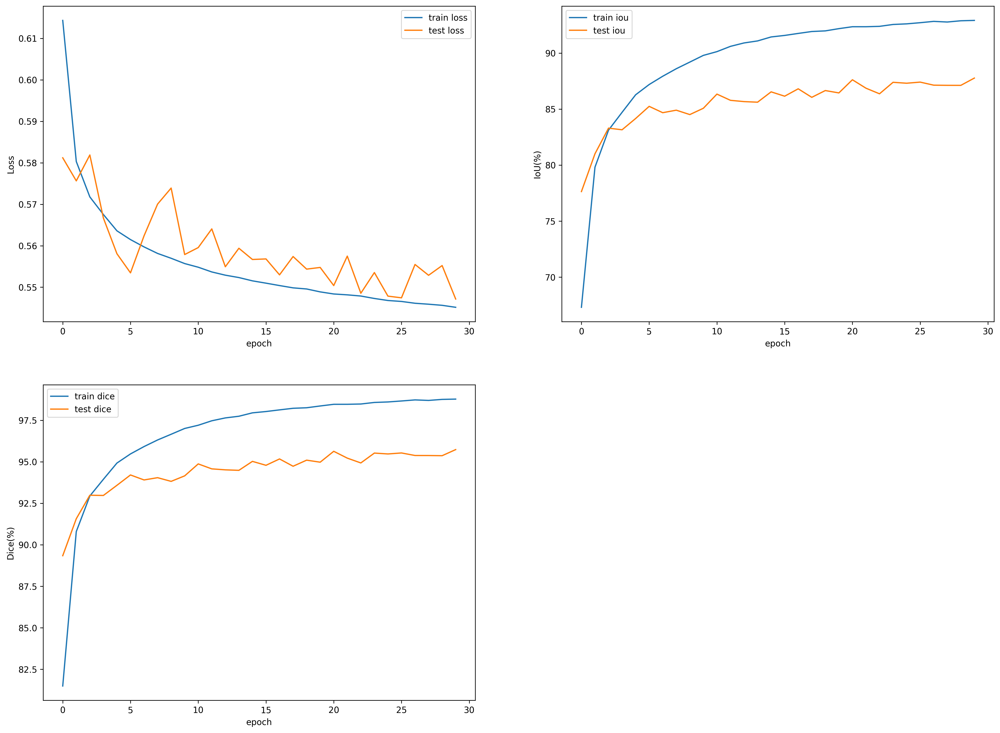

In [17]:
plt.rcParams['figure.dpi'] = 300
os.environ['KMP_DUPLICATE_LIB_OK'] = 'True'
#df=pd.read_csv('ob_detection_v5.csv')
x = [i for i in range(30)]
plt.figure(figsize=(20,15))
plt.subplot(221)
plt.plot(x, df.loc[:,'train_loss'])
plt.plot(x, df.loc[:,'test_loss'])
plt.legend(['train loss','test loss'])
plt.ylabel('Loss')
plt.xlabel('epoch')


plt.subplot(222)
plt.plot(x, df.loc[:,'train_iou'])
plt.plot(x, df.loc[:,'test_iou'])
plt.legend(['train iou','test iou'])
plt.ylabel('IoU(%)')
plt.xlabel('epoch')

plt.subplot(223)
plt.plot(x, df.loc[:,'train_dice'])
plt.plot(x, df.loc[:,'test_dice'])
plt.legend(['train dice','test dice'])
plt.ylabel('Dice(%)')
plt.xlabel('epoch')

* Ref:  
Create segnet: https://github.com/Charmve/Semantic-Segmentation-PyTorch/blob/master/models/seg_net.py  
Upsampling: https://discuss.pytorch.org/t/difference-between-nn-upsample-and-nn-convtranspose2d/32653  
loss function: https://pytorch.org/docs/stable/generated/torch.nn.BCEWithLogitsLoss.html#bcewithlogitsloss
   

# 3.Evaluate your model using the test images

In [18]:
print(f'The maximum iou score in testing set: {df.test_iou.max():.2f}%')
print(f'The maximum dice score in testing set: {df.test_dice.max():.2f}%')

The maximum iou score in testing set: 87.77%
The maximum dice score in testing set: 95.74%


# 4. Your IoU score should be higher than 0.8

C:\Users\User\anaconda3\envs\dlenv\lib\site-packages\ipykernel_launcher.py:35: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


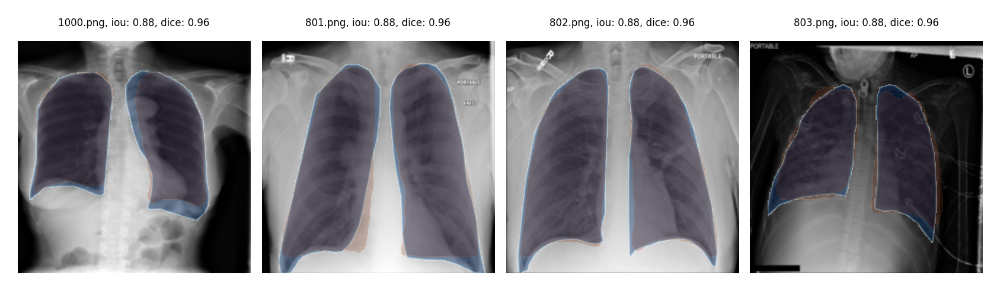

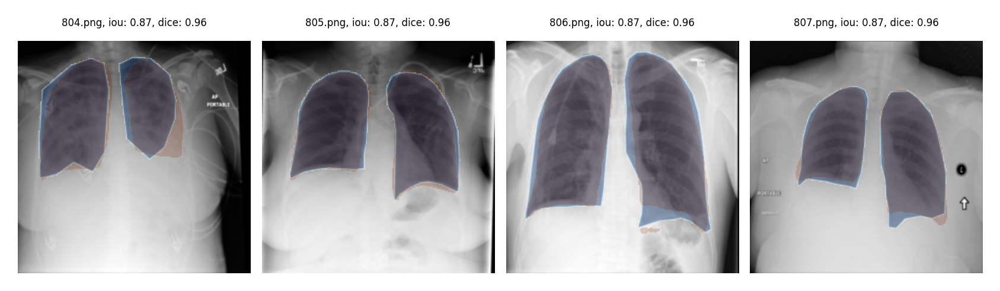

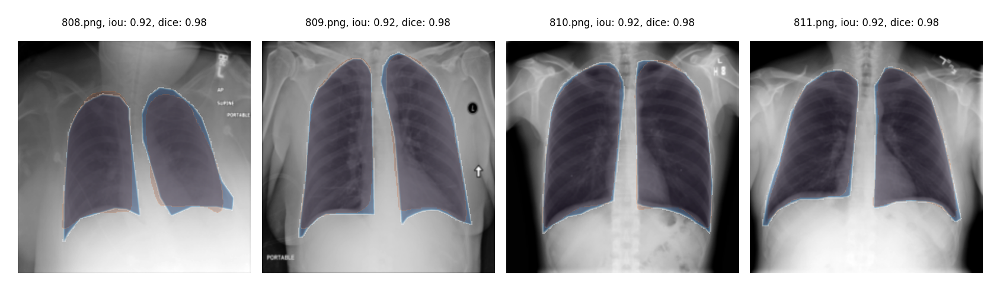

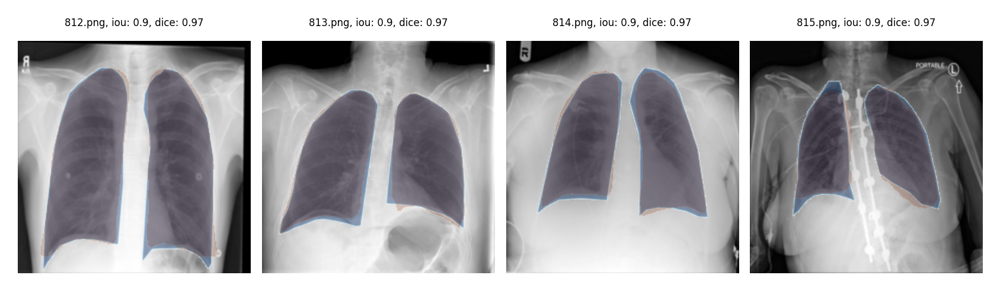

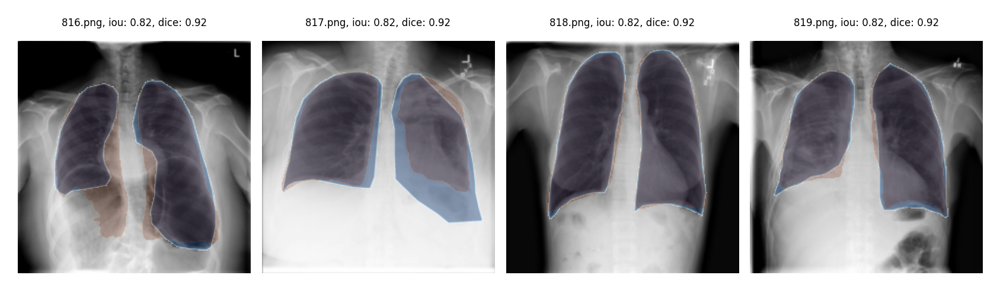

...

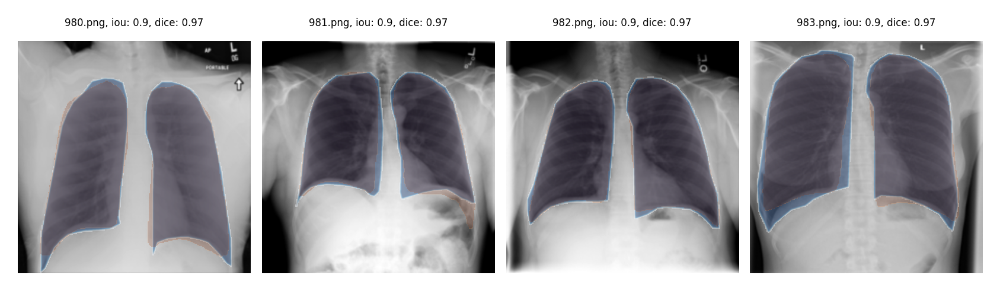

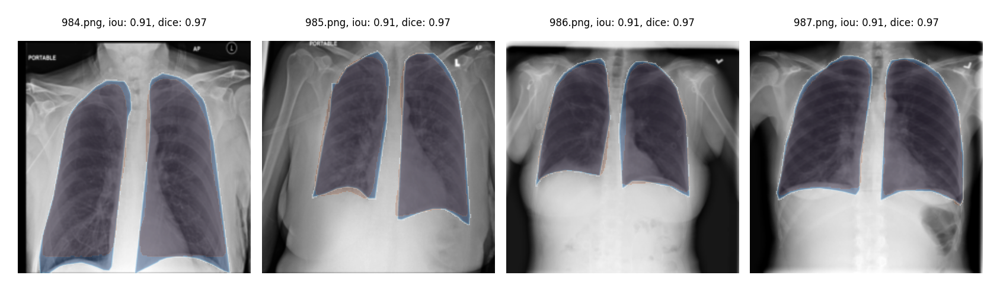

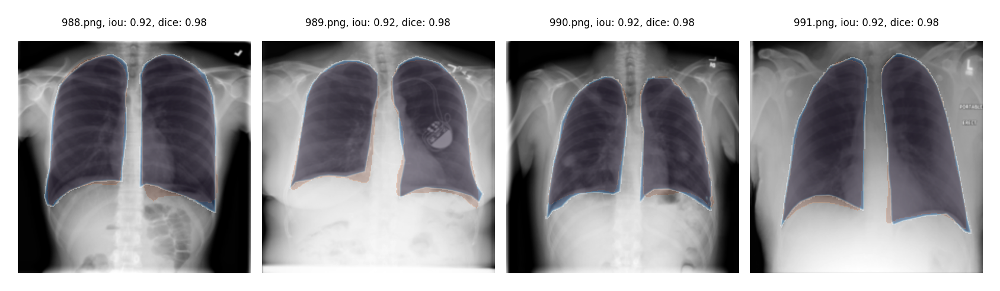

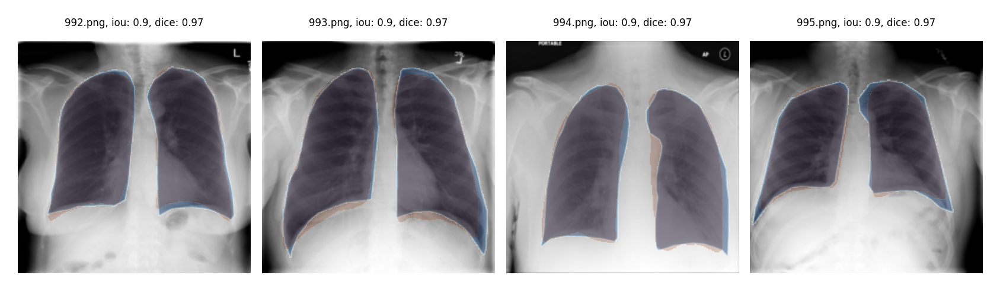

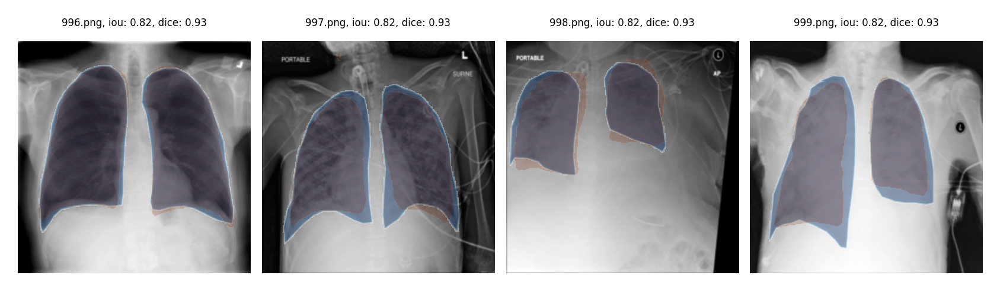

In [35]:
reverse_transform = transforms.Compose([
    transforms.Normalize((-0.485/0.229, -0.456/0.224, -0.406/0.225), (1/0.229, 1/0.224, 1/0.225)),
    transforms.Resize((1024, 1024)),
    transforms.Grayscale(num_output_channels=1)
])

PATH = 'seg_30_v4.pth'
model.load_state_dict(torch.load(PATH))
model.eval()

total_iou, total_dice = 0, 0

for image, mask, img_label, mask_label in test_loader:
        
    # Forward pass
    image, true_mask = image.to('cuda', dtype=torch.float), mask.to('cuda', dtype=torch.float)
 
        
    mask_prediction = model(image)
    os.environ['KMP_DUPLICATE_LIB_OK'] = 'True'
    mask_pred = (mask_prediction > 0.5).float().cpu()
    
    img = reverse_transform(image.cpu())
    resize = transforms.Resize((1024, 1024))
    mask = resize(true_mask)
    mask_pred = resize(mask_pred)
    
    for i in range(mask_pred.shape[0]):
        
        iou, dice = calioudice(mask_prediction, true_mask)
        total_iou += iou
        total_dice += dice
        
        if i % 4 == 0:
            fig, axes = plt.subplots(nrows=1, ncols=4, figsize=(7, 2))
        
        col_index = i % 4
        
        # Plot X-ray image
        axes[col_index].imshow(img[i].permute(1,2,0), 'gray')
        
        # Overlay lung mask on X-ray image
        masked = np.ma.masked_where(mask[i].cpu().squeeze() == 0, mask[i].cpu().squeeze().data)
        masked_pred = np.ma.masked_where(mask_pred[i].cpu().squeeze() == 0, mask_pred[i].cpu().squeeze().data) 
        axes[col_index].imshow(masked, alpha=0.4, cmap='Blues')
        axes[col_index].imshow(masked_pred, alpha=0.2, cmap='Oranges')
        
        axes[col_index].set_title(f'{img_label[i]}, iou: {round(iou.item(),2)}, dice: {round(dice.item(),2)}', fontsize=4)
        axes[col_index].axis('off')
        
        if col_index == 4:
            plt.tight_layout()
            plt.show()
        plt.subplots_adjust(wspace = 0.05, hspace = 0.2)

# 5. Write a 2-page report using LaTex and upload your paper to ResearchGate or Arxiv, and put your paper link here.


https://www.researchgate.net/publication/370400921_Segmentation_of_Lung_Regions_in_Chest_Radiographs

# 6. Grading rubric

(1). Code ------- 20 points (you also need to upload your final model as a pt file, and add paper link)

(2). Grammer ---- 20 points

(3). Introduction & related work --- 10 points

(4). Method  ---- 20 points

(5). Results ---- 20 points

(6). Discussion - 10 points